# ADVANCED VQVAE MODEL FOR FUNDAMENTAL CONCEPT

In [1]:
import numpy as np
import pandas as pd
import os
import glob
import json # for reading annotations from json
from tqdm.auto import tqdm
import random
import math
from PIL import Image,ImageDraw
import tensorflow as tf
from collections import Counter 
from matplotlib import pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
import torch
import torch.nn as nn
import torchvision
from torch.utils.data import DataLoader
import torchvision.models as models
from torch.nn import functional as F
from torchvision import transforms as T
from torch import optim
import yaml
import argparse
from torch.optim.lr_scheduler import ReduceLROnPlateau

from sklearn.metrics import precision_score, recall_score,confusion_matrix,ConfusionMatrixDisplay

# import h5py
# !pip install torchsummary
# from torchsummary import summary

from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True
from torchvision.datasets import ImageFolder
# !pip install einops
# import einops

2024-04-28 14:10:25.815546: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-28 14:10:25.815645: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-28 14:10:25.932680: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [2]:
device=torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [3]:
# Hyperparameters
im_size=256
batch_size=4
latent_shape=(batch_size,4,im_size//8,im_size//8)
seed=53
embedding_dim=128

In [4]:
generator = torch.Generator(device=device)
if seed is None:
    generator.seed()
else:
    generator.manual_seed(seed)

In [5]:
import time
t1=time.time()
transforms=T.Compose([
                T.Resize(im_size),
                T.CenterCrop(im_size),
                T.ToTensor(),
                T.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
            ])

im_dataset=ImageFolder('/kaggle/input/celeba-dataset/img_align_celeba',transform=transforms)
dataloader=torch.utils.data.DataLoader(im_dataset,batch_size=batch_size,
                             shuffle=True)
print(time.time()-t1)

79.27782487869263


In [6]:
# np.var(im_dataset)

# VQVAE Custom

In [7]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.nn import Conv2d, ConvTranspose2d, GroupNorm, Sequential, MultiheadAttention, SiLU, Embedding

class DownBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DownBlock, self).__init__()
        self.resnet_conv_first = nn.Sequential(
            nn.GroupNorm(32, in_channels),
            nn.SiLU(),
            Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=1)
        )
        self.resnet_conv_second = nn.Sequential(
            nn.GroupNorm(32, out_channels),
            nn.SiLU(),
            Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1)
        )
        self.residual_input_conv = Conv2d(in_channels, out_channels, kernel_size=1, stride=1)
        self.down_sample_conv = Conv2d(out_channels, out_channels, kernel_size=4, stride=2, padding=1)

    def forward(self, x):
        residual = self.residual_input_conv(x)
        x = self.resnet_conv_first(x)
        x = self.resnet_conv_second(x)
        x = F.silu(x + residual)
        x = self.down_sample_conv(x)
        return x

class MidBlock(nn.Module):
    def __init__(self, channels):
        super(MidBlock, self).__init__()
        self.resnet_conv_first = nn.Sequential(
            nn.GroupNorm(32, channels),
            nn.SiLU(),
            Conv2d(channels, channels, kernel_size=3, stride=1, padding=1)
        )
        self.resnet_conv_second = nn.Sequential(
            nn.GroupNorm(32, channels),
            nn.SiLU(),
            Conv2d(channels, channels, kernel_size=3, stride=1, padding=1)
        )
        self.attention_norms = nn.GroupNorm(32, channels)
        self.attentions = nn.MultiheadAttention(embed_dim=channels, num_heads=2)
        self.residual_input_conv = Conv2d(channels, channels, kernel_size=1, stride=1)

    def forward(self, x):
        residual = self.residual_input_conv(x)
        x = self.resnet_conv_first(x)
        x = self.resnet_conv_second(x)
        x = F.silu(x + residual)
        B,C,H,W=x.shape
        residual=x
        x=x.reshape(B,C,H*W)
        x = self.attention_norms(x)
        x=x.transpose(1,2)
        x, _ = self.attentions(x, x, x)
        x=x.transpose(1,2).reshape(B,C,W,H)
        return x+residual

class UpBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(UpBlock, self).__init__()
        self.resnet_conv_first = nn.Sequential(
            nn.GroupNorm(32, in_channels),
            nn.SiLU(),
            Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=1)
        )
        self.resnet_conv_second = nn.Sequential(
            nn.GroupNorm(32, out_channels),
            nn.SiLU(),
            Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1)
        )
        self.residual_input_conv = Conv2d(in_channels, out_channels, kernel_size=1, stride=1)
        self.up_sample_conv = ConvTranspose2d(out_channels, out_channels, kernel_size=4, stride=2, padding=1)

    def forward(self, x):
        residual = self.residual_input_conv(x)
        x = self.resnet_conv_first(x)
        x = self.resnet_conv_second(x)
        x = F.silu(x + residual)
        x = self.up_sample_conv(x)
        return x

class VQVAE(nn.Module):
    def __init__(self, input_channels=3, codebook_size=8192):
        super(VQVAE, self).__init__()
        self.encoder_conv_in = Conv2d(input_channels, 64, kernel_size=3, stride=1, padding=1)
        self.encoder_layers = nn.ModuleList([
            DownBlock(64, 128),
            DownBlock(128, 256),
            DownBlock(256, 256)
        ])
        self.encoder_mids = nn.ModuleList([
            MidBlock(256)
        ])
        self.encoder_norm_out = GroupNorm(32, 256)
        self.encoder_conv_out = Conv2d(256, input_channels, kernel_size=3, stride=1, padding=1)
        self.pre_quant_conv = Conv2d(input_channels, input_channels, kernel_size=1, stride=1)
        self.embedding = Embedding(codebook_size, input_channels)#this embedding_dim should match pre_quant_conv channels
        self.post_quant_conv = Conv2d(input_channels, 16, kernel_size=1, stride=1)
        self.decoder_conv_in = Conv2d(16, 256, kernel_size=3, stride=1, padding=1)
        self.decoder_mids = nn.ModuleList([
            MidBlock(256)
        ])
        self.decoder_layers = nn.ModuleList([
            UpBlock(256, 256),
            UpBlock(256, 128),
            UpBlock(128, 64)
        ])
        self.decoder_norm_out = GroupNorm(32, 64)
        self.decoder_conv_out = Conv2d(64, input_channels, kernel_size=3, stride=1, padding=1)

        
    
    def quantize(self, x):
        B, C, H, W = x.shape
        
        # B, C, H, W -> B, H, W, C
#         print(x.shape)
        x = x.permute(0, 2, 3, 1)
        
        # B, H, W, C -> B, H*W, C
        x = x.reshape(x.size(0), -1, x.size(-1))
#         print(x.shape,self.embedding.weight.shape)
        # Find nearest embedding/codebook vector
        # dist between (B, H*W, C) and (B, K, C) -> (B, H*W, K)
        dist = torch.cdist(x, self.embedding.weight[None, :].repeat((x.size(0), 1, 1)))
        # (B, H*W)
        min_encoding_indices = torch.argmin(dist, dim=-1)
        
        # Replace encoder output with nearest codebook
        # quant_out -> B*H*W, C
        quant_out = torch.index_select(self.embedding.weight, 0, min_encoding_indices.view(-1))
        
        # x -> B*H*W, C
        x = x.reshape((-1, x.size(-1)))
        commmitment_loss = torch.mean((quant_out.detach() - x) ** 2)
        codebook_loss = torch.mean((quant_out - x.detach()) ** 2)
        quantize_losses = {
            'codebook_loss': codebook_loss,
            'commitment_loss': commmitment_loss
        }
        # Straight through estimation
        quant_out = x + (quant_out - x).detach()
        
        # quant_out -> B, C, H, W
        quant_out = quant_out.reshape((B, H, W, C)).permute(0, 3, 1, 2)
        min_encoding_indices = min_encoding_indices.reshape((-1, quant_out.size(-2), quant_out.size(-1)))
        return quant_out, quantize_losses, min_encoding_indices
    
    
    def encode(self,x):
        x = self.encoder_conv_in(x)
        for layer in self.encoder_layers:
            x = layer(x)
        for layer in self.encoder_mids:
            x = layer(x)
        x = self.encoder_norm_out(x)
        x = self.encoder_conv_out(x)
        x = self.pre_quant_conv(x)
        out, quant_losses, _ = self.quantize(x)
        return out,quant_losses
    
    
    def decode(self,x):
        x=self.post_quant_conv(x)
        x = self.decoder_conv_in(x)
        for layer in self.decoder_mids:
            x = layer(x)
        for layer in self.decoder_layers:
            x = layer(x)
        x = self.decoder_norm_out(x)
        x = self.decoder_conv_out(x)
        return x
    
    def forward(self, x):
        # Encoder
        z,quant_losses=self.encode(x)
        # print('Encoding Completed',x.shape)
        
        # Decoder
        output=self.decode(z)
        
        return output,z,quant_losses


In [8]:
model=VQVAE().to(device)
optimizer=optim.Adam(model.parameters(),lr=0.00001,betas=(0.5, 0.999))
criterion=nn.MSELoss()

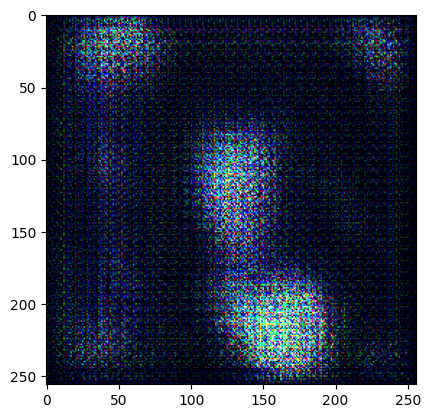

In [9]:
x=next(iter(dataloader))[0].to(device)
ans,_,_=model(x)
plt.imshow(ans[1].permute(1,2,0).detach().cpu().numpy())

In [10]:
def test():
    model.eval()
    with torch.no_grad():
        x=next(iter(dataloader))[0].to(device)
        generated_out,_,_=model(x)
        x=(x+1)/2
        generated_out=(generated_out+1)/2
        out=torch.concat([x,generated_out])
        plt.imshow(np.transpose(torchvision.utils.make_grid(out.to(device),nrow=4).cpu().numpy(),(1,2,0)))
        plt.show()
#     plt.imshow(x[1].permute(1,2,0).detach().cpu().numpy())

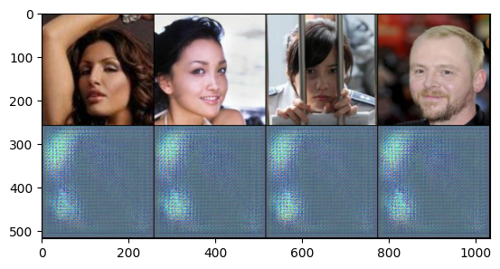

In [11]:
test()

In [12]:
def train():
    model.train()
    num_epochs=2
    train_res_recon_error = []
    train_res_perplexity = []
    losses=[]
    codebook_losses = []
    commitment_losses = []
    for epoch_idx in range(num_epochs):
        count=0
        print(f'-----Running epoch[{epoch_idx+1}]-----')
        for im,label in tqdm(dataloader):
            model.train()
            count+=1
            im=im.float().to(device)
            optimizer.zero_grad()
            data_recon,_,vq_loss=model(im)
            
            recon_error = F.mse_loss(data_recon, im)
            loss = recon_error + vq_loss['codebook_loss']+0.2*vq_loss['commitment_loss']
            codebook_losses.append(vq_loss['codebook_loss'].item())
            commitment_losses.append(vq_loss['commitment_loss'].item())
            losses.append(loss.detach().cpu())
            
            loss.backward()
            optimizer.step()
            if count%1000==0:
                test()
#                 break
        
        print('epoch_loss:',np.mean(losses),'Codebook_Loss:',np.mean(codebook_losses),
             'Commitment_Loss:',np.mean(commitment_losses))

-----Running epoch[1]-----


  0%|          | 0/50650 [00:00<?, ?it/s]

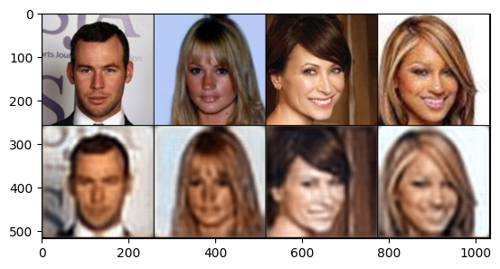

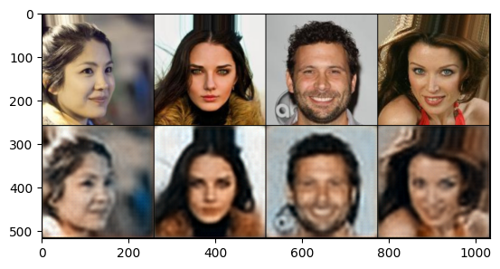

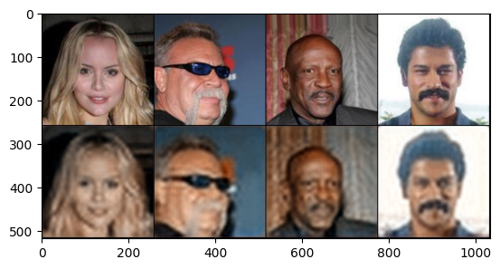

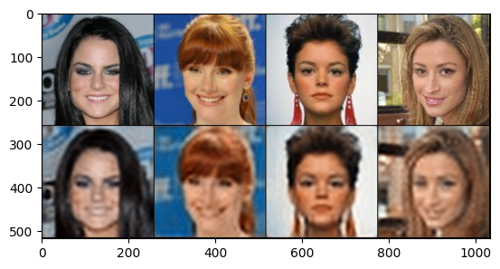

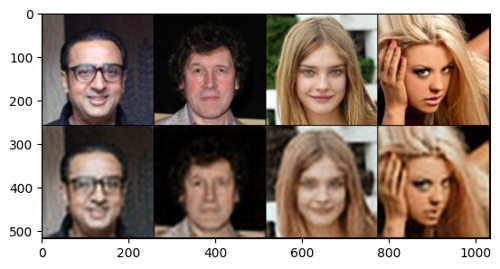

...

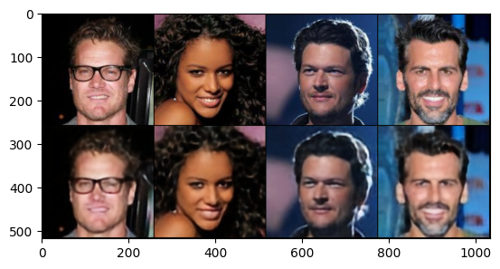

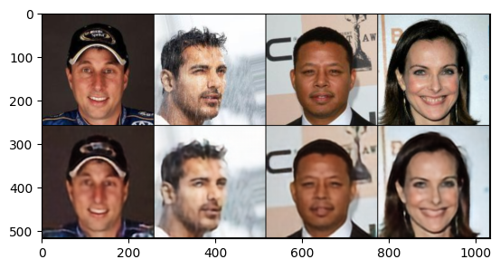

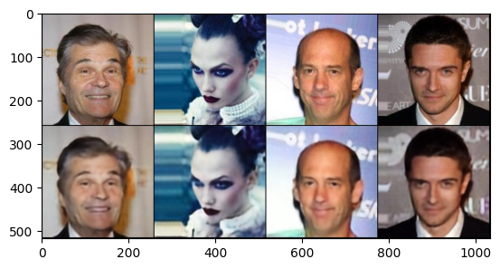

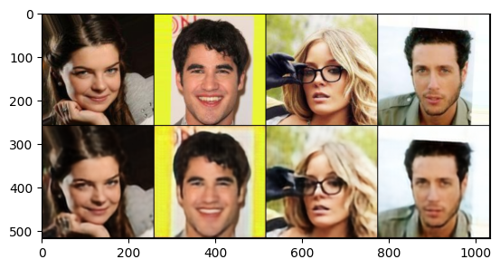

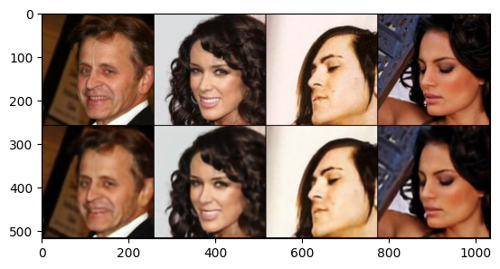

epoch_loss: 0.010787138 Codebook_Loss: 0.001564229718689427 Commitment_Loss: 0.001564229718689427
-----Running epoch[2]-----


  0%|          | 0/50650 [00:00<?, ?it/s]

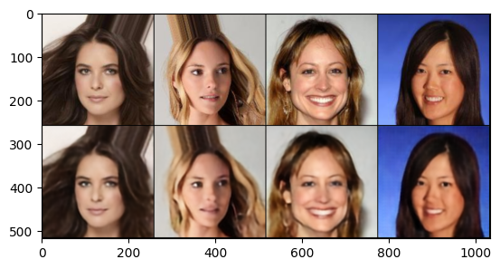

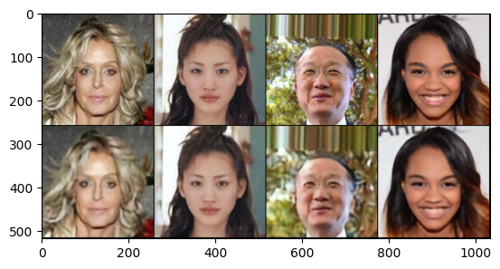

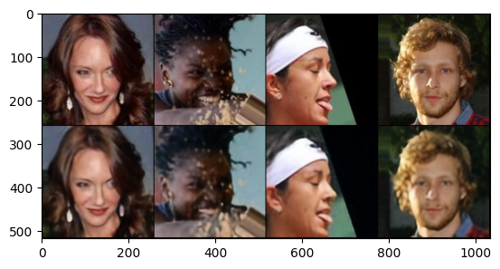

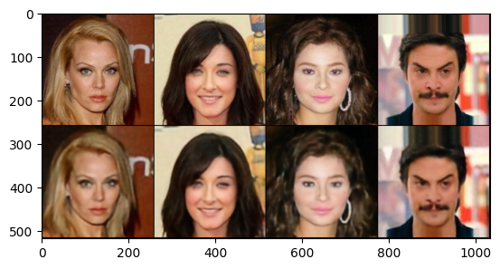

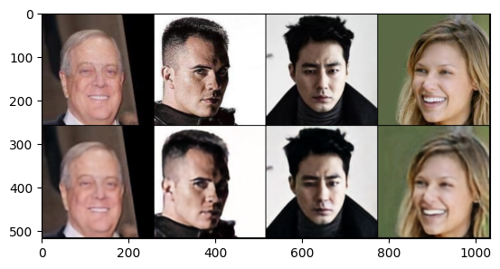

...

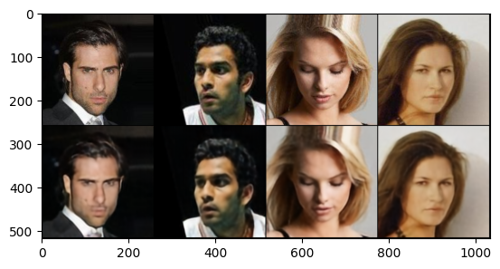

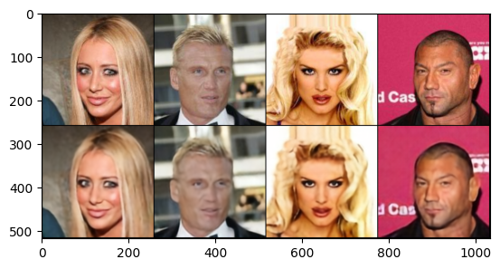

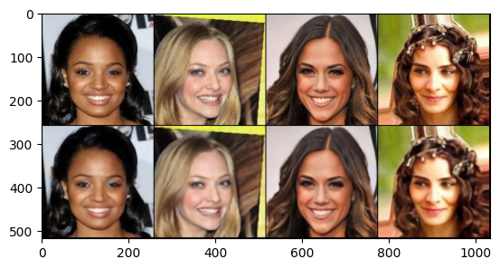

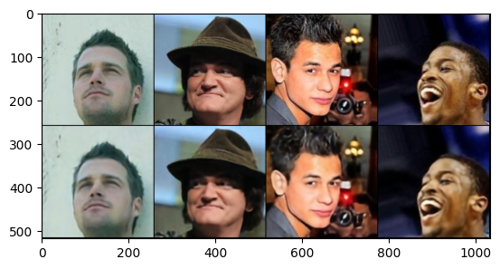

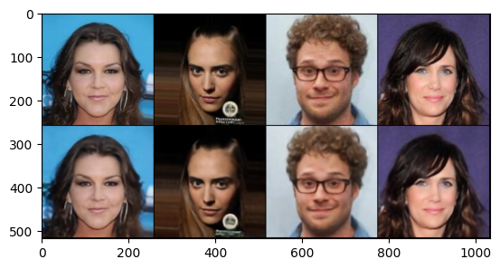

epoch_loss: 0.008145066 Codebook_Loss: 0.0016779581781523624 Commitment_Loss: 0.0016779581781523624


In [13]:
train()

In [14]:
torch.save(model.state_dict(),'ver1.pth')